# Exploring the OpenFDA API - Rough Workbook

In [3]:
import requests
import json
from config import api_key

The main objective in this notebook is to explore the structure of the API calls and the resulting response from OpenFDA Adverse Drug Effect (ADE) events. 
There are two ways the data can be accessed 1. with API key and 2. without an API key. Furthermore, there are limits on how many queries can be carried out within a time period and also the number of results. 

With API key, we get 120,000 API calls per day per key and without an API key it is limited to 1000 calls.

### Response structure

There are two types of queries that can be carried out:

1. Search query: A specific search query that satisfies a certain specified condition. In this case, the response consists of two main fields, "meta" and "results". Meta includes information such as disclaimer, license, number of results etc. The main results are in the "results" field.

2. Count query: This type of queries returns the count of the events specified. This can be combined with the search term. Count queries result contains a dictionary of terms and counts

An example search query and result

In [57]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?search=receivedate:[20040101+TO+20081231]&limit=10" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()
response['results']

[{'receiptdateformat': '102',
  'receiver': None,
  'companynumb': 'HQWYE821915MAR04',
  'receivedateformat': '102',
  'primarysource': None,
  'seriousnessother': '1',
  'transmissiondateformat': '102',
  'fulfillexpeditecriteria': '1',
  'safetyreportid': '4322505-4',
  'sender': {'senderorganization': 'FDA-Public Use'},
  'receivedate': '20040319',
  'patient': {'patientonsetage': '56',
   'reaction': [{'reactionmeddrapt': 'ARTHRALGIA'},
    {'reactionmeddrapt': 'OEDEMA PERIPHERAL'},
    {'reactionmeddrapt': 'PURPURA'}],
   'patientonsetageunit': '801',
   'patientsex': '1',
   'drug': [{'drugstartdateformat': '102',
     'drugindication': 'PYELONEPHRITIS',
     'drugadministrationroute': '048',
     'drugtreatmentduration': '4',
     'drugcharacterization': '1',
     'drugstartdate': '20031227',
     'drugenddateformat': '102',
     'drugtreatmentdurationunit': '804',
     'drugdosagetext': 'ORAL',
     'drugauthorizationnumb': '50621',
     'drugenddate': '20031230',
     'medicin

In [58]:
df=pd.DataFrame(response['results'])
df

,receiptdateformat,receiver,companynumb,receivedateformat,primarysource,seriousnessother,transmissiondateformat,fulfillexpeditecriteria,safetyreportid,sender,receivedate,patient,seriousnesshospitalization,transmissiondate,serious,receiptdate,seriousnessdeath,seriousnesslifethreatening
0,102,None,HQWYE821915MAR04,102,None,1,102,1,4322505-4,{'senderorganization': 'FDA-Public Use'},20040319,"{'patientonsetage': '56', 'reaction': [{'react...",1,20041129,1,20040315,NaN,NaN
1,102,None,JACAN16471,102,"{'qualification': '3', 'reportercountry': 'CAN...",NaN,102,1,5801206-7,{'senderorganization': 'FDA-Public Use'},20080707,"{'patientonsetage': '26', 'patientdeath': {'pa...",NaN,20090109,1,20080625,1,NaN
2,102,None,WAES 97101426,102,None,NaN,102,1,4318221-5,{'senderorganization': 'FDA-Public Use'},20040315,"{'patientonsetage': '8', 'reaction': [{'reacti...",1,20041129,1,20040228,1,1
3,102,None,CDN/97/00530/LEX,102,{'reportercountry': 'CANADA'},NaN,102,1,5015436-8,{'senderorganization': 'FDA-Public Use'},20060601,"{'patientonsetage': '22', 'reaction': [{'react...",1,20061013,1,19970918,NaN,1
4,102,None,USA/97/02459/LAS,102,{'qualification': '1'},1,102,1,4412763-X,{'senderorganization': 'FDA-Public Use'},20040802,"{'patientonsetage': '78', 'reaction': [{'react...",1,20050211,1,19970904,NaN,NaN
5,102,None,1997002193-FJ,102,{'qualification': '1'},NaN,102,1,4338356-0,{'senderorganization': 'FDA-Public Use'},20040407,"{'patientonsetage': '30', 'reaction': [{'react...",1,20050107,1,20040323,NaN,NaN
6,102,None,971223-008013562,102,"{'reportercountry': 'BELGIUM', 'qualification'...",1,102,2,5210389-1,{'senderorganization': 'FDA-Public Use'},20070117,"{'patientonsetage': '4', 'reaction': [{'reacti...",NaN,20070707,1,20070110,NaN,NaN
7,102,None,971211-008013452,102,"{'reportercountry': 'BELGIUM', 'qualification'...",NaN,102,2,5215788-X,{'senderorganization': 'FDA-Public Use'},20070123,{'reaction': [{'reactionmeddrapt': 'ARRHYTHMIA...,1,20070707,1,20070110,NaN,NaN
8,102,None,US97040775A,102,None,1,102,1,4474049-7,{'senderorganization': 'FDA-Public Use'},20041008,"{'patientonsetage': '60', 'reaction': [{'react...",NaN,20050328,1,20040920,NaN,NaN
9,102,None,JAFRA37402,102,{'qualification': '1'},NaN,102,1,4598678-5,{'senderorganization': 'FDA-Public Use'},20050304,"{'patientonsetage': '29', 'reaction': [{'react...",1,20050727,1,20050221,NaN,NaN


In [63]:
search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()
response['results']

[{'term': 'DRUG INEFFECTIVE', 'count': 733191},
 {'term': 'NAUSEA', 'count': 485098},
 {'term': 'DEATH', 'count': 474541},
 {'term': 'FATIGUE', 'count': 439328},
 {'term': 'HEADACHE', 'count': 388310},
 {'term': 'DIARRHOEA', 'count': 359872},
 {'term': 'DYSPNOEA', 'count': 344540},
 {'term': 'PAIN', 'count': 326354},
 {'term': 'OFF LABEL USE', 'count': 324957},
 {'term': 'DIZZINESS', 'count': 313617},
 {'term': 'MALAISE', 'count': 292069},
 {'term': 'VOMITING', 'count': 288474},
 {'term': 'RASH', 'count': 239284},
 {'term': 'ASTHENIA', 'count': 231802},
 {'term': 'ARTHRALGIA', 'count': 223301},
 {'term': 'PYREXIA', 'count': 212052},
 {'term': 'FALL', 'count': 205052},
 {'term': 'PRURITUS', 'count': 191513},
 {'term': 'PNEUMONIA', 'count': 191376},
 {'term': 'PAIN IN EXTREMITY', 'count': 189709},
 {'term': 'ANXIETY', 'count': 179536},
 {'term': 'INSOMNIA', 'count': 175000},
 {'term': 'INJECTION SITE PAIN', 'count': 168450},
 {'term': 'DRUG DOSE OMISSION', 'count': 166417},
 {'term': 'WE

In [64]:
df=pd.DataFrame(response['results'])
df

,term,count
0,DRUG INEFFECTIVE,733191
1,NAUSEA,485098
2,DEATH,474541
3,FATIGUE,439328
4,HEADACHE,388310
...,...,...
95,DRY SKIN,64845
96,INFLUENZA,63945
97,HAEMORRHAGE,63926
98,ABDOMINAL DISTENSION,62971


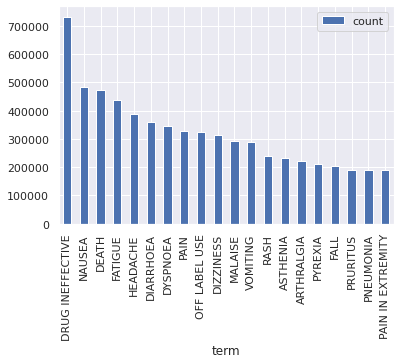

In [77]:
df.iloc[0:20].plot(x="term", y="count", kind="bar");

In [98]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?search=primarysource.qualification:1+AND+seriousnessdeath:1+AND+patient.patientsex:2+AND+patient.patientonsetage:[50+TO+90]&count=patient.reaction.reactionmeddrapt.exact" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()
response['results']

[{'term': 'DEATH', 'count': 19218},
 {'term': 'COMPLETED SUICIDE', 'count': 6357},
 {'term': 'PNEUMONIA', 'count': 3661},
 {'term': 'TOXICITY TO VARIOUS AGENTS', 'count': 3229},
 {'term': 'SEPSIS', 'count': 3052},
 {'term': 'CARDIAC ARREST', 'count': 2987},
 {'term': 'DISEASE PROGRESSION', 'count': 2511},
 {'term': 'RESPIRATORY FAILURE', 'count': 2379},
 {'term': 'DYSPNOEA', 'count': 2313},
 {'term': 'MALIGNANT NEOPLASM PROGRESSION', 'count': 2296},
 {'term': 'DIARRHOEA', 'count': 2210},
 {'term': 'MYOCARDIAL INFARCTION', 'count': 2169},
 {'term': 'CARDIO-RESPIRATORY ARREST', 'count': 2128},
 {'term': 'CARDIAC FAILURE', 'count': 1766},
 {'term': 'ANAEMIA', 'count': 1763},
 {'term': 'NAUSEA', 'count': 1759},
 {'term': 'GENERAL PHYSICAL HEALTH DETERIORATION', 'count': 1731},
 {'term': 'RENAL FAILURE', 'count': 1710},
 {'term': 'VOMITING', 'count': 1691},
 {'term': 'PYREXIA', 'count': 1610},
 {'term': 'FALL', 'count': 1512},
 {'term': 'SEPTIC SHOCK', 'count': 1505},
 {'term': 'ASTHENIA', 

In [84]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?search=primarysource.qualification:1&count=patient.drug.openfda.pharm_class_epc.exact" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()
response['results']

[{'term': 'Angiotensin Converting Enzyme Inhibitor [EPC]', 'count': 26497},
 {'term': 'Insulin Analog [EPC]', 'count': 26000},
 {'term': 'Purine Antimetabolite [EPC]', 'count': 13099},
 {'term': 'Human Immunodeficiency Virus Nucleoside Analog Reverse Transcriptase Inhibitor [EPC]',
  'count': 7807},
 {'term': 'Tetracycline-class Drug [EPC]', 'count': 7015},
 {'term': 'Stimulant Laxative [EPC]', 'count': 2458},
 {'term': 'Antiarrhythmic [EPC]', 'count': 1384},
 {'term': 'Anti-coagulant [EPC]', 'count': 238},
 {'term': 'Direct Thrombin Inhibitor [EPC]', 'count': 238},
 {'term': 'Leptin Analog [EPC]', 'count': 210},
 {'term': 'GLP-2 Analog [EPC]', 'count': 160},
 {'term': 'Vitamin B6 Analog [EPC]', 'count': 8}]

In [85]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?count=patient.drug.openfda.pharm_class_epc.exact" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()
response['results']

[{'term': 'Insulin Analog [EPC]', 'count': 174342},
 {'term': 'Angiotensin Converting Enzyme Inhibitor [EPC]', 'count': 81456},
 {'term': 'Purine Antimetabolite [EPC]', 'count': 43553},
 {'term': 'Tetracycline-class Drug [EPC]', 'count': 30468},
 {'term': 'Human Immunodeficiency Virus Nucleoside Analog Reverse Transcriptase Inhibitor [EPC]',
  'count': 26223},
 {'term': 'Stimulant Laxative [EPC]', 'count': 9427},
 {'term': 'Antiarrhythmic [EPC]', 'count': 5041},
 {'term': 'Anti-coagulant [EPC]', 'count': 992},
 {'term': 'Direct Thrombin Inhibitor [EPC]', 'count': 992},
 {'term': 'GLP-2 Analog [EPC]', 'count': 641},
 {'term': 'Leptin Analog [EPC]', 'count': 583},
 {'term': 'Vitamin B6 Analog [EPC]', 'count': 79}]

In [100]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?search=primarysource.qualification:1+AND+seriousnessdeath:1&count=occurcountry" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()
response['results']

[{'term': 'us', 'count': 103994},
 {'term': 'jp', 'count': 26551},
 {'term': 'fr', 'count': 10545},
 {'term': 'de', 'count': 10485},
 {'term': 'gb', 'count': 8442},
 {'term': 'ca', 'count': 6665},
 {'term': 've', 'count': 5053},
 {'term': 'it', 'count': 4535},
 {'term': 'es', 'count': 3874},
 {'term': 'in', 'count': 3684},
 {'term': 'au', 'count': 3218},
 {'term': 'br', 'count': 3085},
 {'term': 'nl', 'count': 2588},
 {'term': 'cn', 'count': 2413},
 {'term': 'pl', 'count': 2034},
 {'term': 'be', 'count': 1795},
 {'term': 'tr', 'count': 1686},
 {'term': 'ch', 'count': 1649},
 {'term': 'at', 'count': 1539},
 {'term': 'kr', 'count': 1464},
 {'term': 'tw', 'count': 1448},
 {'term': 'gr', 'count': 1286},
 {'term': 'mx', 'count': 1191},
 {'term': 'il', 'count': 1131},
 {'term': 'za', 'count': 1072},
 {'term': 'se', 'count': 1010},
 {'term': 'cz', 'count': 1008},
 {'term': 'ru', 'count': 1005},
 {'term': 'pt', 'count': 955},
 {'term': 'hu', 'count': 917},
 {'term': 'ar', 'count': 870},
 {'ter

In [105]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?search=primarysource.qualification:1+AND+seriousnessdeath:1&count=occurcountry" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()

if "error" in response:
    print("No results")
else:
    print(response['results'])

[{'term': 'us', 'count': 103994}, {'term': 'jp', 'count': 26551}, {'term': 'fr', 'count': 10545}, {'term': 'de', 'count': 10485}, {'term': 'gb', 'count': 8442}, {'term': 'ca', 'count': 6665}, {'term': 've', 'count': 5053}, {'term': 'it', 'count': 4535}, {'term': 'es', 'count': 3874}, {'term': 'in', 'count': 3684}, {'term': 'au', 'count': 3218}, {'term': 'br', 'count': 3085}, {'term': 'nl', 'count': 2588}, {'term': 'cn', 'count': 2413}, {'term': 'pl', 'count': 2034}, {'term': 'be', 'count': 1795}, {'term': 'tr', 'count': 1686}, {'term': 'ch', 'count': 1649}, {'term': 'at', 'count': 1539}, {'term': 'kr', 'count': 1464}, {'term': 'tw', 'count': 1448}, {'term': 'gr', 'count': 1286}, {'term': 'mx', 'count': 1191}, {'term': 'il', 'count': 1131}, {'term': 'za', 'count': 1072}, {'term': 'se', 'count': 1010}, {'term': 'cz', 'count': 1008}, {'term': 'ru', 'count': 1005}, {'term': 'pt', 'count': 955}, {'term': 'hu', 'count': 917}, {'term': 'ar', 'count': 870}, {'term': 'ro', 'count': 868}, {'term

In [102]:
base_link="https://api.fda.gov/drug/event.json"
search_term="?search=primarysource.qualification:1+AND+seriousnessdeath:1&count=occurcountry" 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()

if "error" in response:
    print("No results")
else:
    print(response['results'])

{'error': {'code': 'NOT_FOUND', 'message': 'No matches found!'}}

In [127]:
base_link="https://api.fda.gov/drug/event.json"
search_term='?search=patient.reaction.reactionmeddrapt:"death"+AND+primarysource.qualification:1&count=patient.drug.openfda.generic_name.exact' 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term

response=requests.get(link, headers=headers).json()

if "error" in response:
    print("No results")
else:
    print(response['results'])

[{'term': 'BOSENTAN', 'count': 4555}, {'term': 'BEVACIZUMAB', 'count': 4475}, {'term': 'DEXAMETHASONE', 'count': 4112}, {'term': 'DEXAMETHASONE 1.5 MG', 'count': 2970}, {'term': 'FUROSEMIDE', 'count': 2875}, {'term': 'PARICALCITOL', 'count': 2753}, {'term': 'ASPIRIN', 'count': 2604}, {'term': 'ASPIRIN 81MG', 'count': 2526}, {'term': 'ASPIRIN 325 MG', 'count': 2524}, {'term': 'ASPIRIN 81 MG', 'count': 2524}, {'term': 'ACETAMINOPHEN', 'count': 2231}, {'term': 'PREDNISONE', 'count': 2137}, {'term': 'LENALIDOMIDE', 'count': 2109}, {'term': 'ALPRAZOLAM', 'count': 1780}, {'term': 'OMEPRAZOLE MAGNESIUM', 'count': 1670}, {'term': 'GABAPENTIN', 'count': 1589}, {'term': 'POMALIDOMIDE', 'count': 1435}, {'term': 'DIPHENHYDRAMINE HYDROCHLORIDE', 'count': 1429}, {'term': 'LORAZEPAM', 'count': 1392}, {'term': 'SUNITINIB MALATE', 'count': 1359}, {'term': 'ACETAMINOPHEN 325MG', 'count': 1342}, {'term': 'ACETAMINOPHEN CAPLET, 500 MG EXTRA STRENGTH', 'count': 1342}, {'term': 'ACETAMINOPHEN, DIPHENHYDRAMI

In [116]:
response['results']

[{'term': 'ASPIRIN', 'count': 17650},
 {'term': 'LEVOTHYROXINE SODIUM', 'count': 15399},
 {'term': 'ADALIMUMAB', 'count': 14731},
 {'term': 'CHOLECALCIFEROL', 'count': 13763},
 {'term': 'PREDNISONE', 'count': 12835},
 {'term': 'ACETAMINOPHEN', 'count': 11560},
 {'term': 'ETANERCEPT', 'count': 11276},
 {'term': 'AMLODIPINE BESYLATE', 'count': 10108},
 {'term': 'GABAPENTIN', 'count': 9970},
 {'term': 'OMEPRAZOLE', 'count': 9128},
 {'term': 'METHOTREXATE', 'count': 8653},
 {'term': 'FUROSEMIDE', 'count': 8585},
 {'term': 'METFORMIN HYDROCHLORIDE', 'count': 8509},
 {'term': 'LENALIDOMIDE', 'count': 8263},
 {'term': 'DEXAMETHASONE', 'count': 7952},
 {'term': 'LISINOPRIL', 'count': 7849},
 {'term': 'VITAMINS', 'count': 7670},
 {'term': 'LEVOTHYROXINE', 'count': 7530},
 {'term': 'ENZALUTAMIDE', 'count': 7233},
 {'term': 'FINGOLIMOD HYDROCHLORIDE', 'count': 7106},
 {'term': 'PALBOCICLIB', 'count': 6898},
 {'term': 'FOLIC ACID', 'count': 6875},
 {'term': 'DULOXETINE HYDROCHLORIDE', 'count': 685

In [240]:
base_link="https://api.fda.gov/drug/event.json"
search_term='?search="avastin"+AND+primarysource.qualification:1&limit=2'
search_term='?search="avastin"+AND+primarysource.qualification:1&count=patient.drug.openfda.generic_name.exact'
#search_term='?search=patient.reaction.reactionmeddrapt:"death"+AND+primarysource.qualification:1+AND+patient.patientonsetage:[5+TO+17]' 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term
print(link)

response=requests.get(link, headers=headers).json()
response['results']


https://api.fda.gov/drug/event.json?search="avastin"+AND+primarysource.qualification:1&count=patient.drug.openfda.generic_name.exact


[{'term': 'BEVACIZUMAB', 'count': 35851},
 {'term': 'OXALIPLATIN', 'count': 5665},
 {'term': 'CARBOPLATIN', 'count': 5379},
 {'term': 'FLUOROURACIL', 'count': 5322},
 {'term': 'CAPECITABINE', 'count': 5165},
 {'term': 'PACLITAXEL', 'count': 4988},
 {'term': 'DEXAMETHASONE', 'count': 3253},
 {'term': 'LEUCOVORIN CALCIUM', 'count': 2242},
 {'term': 'ONDANSETRON HYDROCHLORIDE', 'count': 1882},
 {'term': 'GEMCITABINE HYDROCHLORIDE', 'count': 1726},
 {'term': 'DOCETAXEL', 'count': 1664},
 {'term': 'DEXAMETHASONE 1.5 MG', 'count': 1626},
 {'term': 'CISPLATIN', 'count': 1573},
 {'term': 'PALONOSETRON HYDROCHLORIDE', 'count': 1276},
 {'term': 'ERLOTINIB HYDROCHLORIDE', 'count': 1113},
 {'term': 'DOCETAXEL ANHYDROUS', 'count': 1041},
 {'term': 'IRINOTECAN HYDROCHLORIDE', 'count': 1036},
 {'term': 'LORAZEPAM', 'count': 1006},
 {'term': 'DIPHENHYDRAMINE HYDROCHLORIDE', 'count': 996},
 {'term': 'ATEZOLIZUMAB', 'count': 985},
 {'term': 'ACETAMINOPHEN', 'count': 928},
 {'term': 'ZOLEDRONIC ACID', 'c

In [307]:
base_link="https://api.fda.gov/drug/event.json"
search_term='?search="afinitor"+AND+primarysource.qualification:1&limit=1000'
#search_term='?search="everolimus"+AND+primarysource.qualification:1&count=patient.drug.openfda.generic_name.exact'
#search_term='?search=patient.reaction.reactionmeddrapt:"death"+AND+primarysource.qualification:1+AND+patient.patientonsetage:[5+TO+17]' 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term
print(link)

response=requests.get(link, headers=headers).json()
#len(response['results'])

https://api.fda.gov/drug/event.json?search="afinitor"+AND+primarysource.qualification:1&limit=2000


In [308]:
response['meta']

KeyError: 'meta'

In [280]:
no_of_reports=response['results']
product={}
for result in response['results']:
    if 'patient' in result.keys():
        #print(result['patient']['reaction'])
        for reaction in result['patient']['reaction']:
            #print(reaction['reactionmeddrapt'])
            key=reaction['reactionmeddrapt']
            product[key]=avastin.get(key,0)+1
                    

product={ k: v for k, v in product.items() if v >= 20 }
product["product"]="afinitor"
                       

In [281]:
base_link="https://api.fda.gov/drug/event.json"
search_term='?search="avastin"+AND+primarysource.qualification:1&limit=1000'
#search_term='?search="everolimus"+AND+primarysource.qualification:1&count=patient.drug.openfda.generic_name.exact'
#search_term='?search=patient.reaction.reactionmeddrapt:"death"+AND+primarysource.qualification:1+AND+patient.patientonsetage:[5+TO+17]' 
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'

headers={"api_key": api_key}

link=base_link+search_term
print(link)

response=requests.get(link, headers=headers).json()
no_of_reports=response['results']
product2={}
for result in response['results']:
    if 'patient' in result.keys():
        #print(result['patient']['reaction'])
        for reaction in result['patient']['reaction']:
            #print(reaction['reactionmeddrapt'])
            key=reaction['reactionmeddrapt']
            product2[key]=product2.get(key,0)+1
                    

product2={ k: v for k, v in product2.items() if v >= 20 }
product2['product']="avastin"

#response['results']

https://api.fda.gov/drug/event.json?search="avastin"+AND+primarysource.qualification:1&limit=1000


In [284]:
print(product)
print(product2)
df=pd.DataFrame([product, product2])
df['product']

{'Stomatitis': 83, 'Weight decreased': 29, 'Death': 137, 'Diarrhoea': 68, 'Nausea': 37, 'Rash': 43, 'Blood creatinine increased': 25, 'Urinary tract infection': 21, 'Vomiting': 29, 'Oedema peripheral': 23, 'Fatigue': 60, 'Decreased appetite': 39, 'Dyspnoea': 101, 'Pleural effusion': 44, 'Malignant neoplasm progression': 120, 'Pneumonitis': 60, 'General physical health deterioration': 50, 'Thrombocytopenia': 29, 'Hyperglycaemia': 28, 'Asthenia': 27, 'Pneumonia': 34, 'Metastases to liver': 27, 'Pain': 26, 'Malaise': 36, 'Mucosal inflammation': 28, 'Anaemia': 55, 'Cough': 71, 'Pyrexia': 75, 'Disease progression': 32, 'Platelet count decreased': 24, 'Abdominal pain': 24, 'Interstitial lung disease': 48, 'Acute kidney injury': 21, 'product': 'afinitor'}
{'Pyrexia': 48, 'Vomiting': 43, 'Nausea': 43, 'Anaemia': 28, 'Disease progression': 100, 'Malignant neoplasm progression': 29, 'Abdominal pain': 23, 'Diarrhoea': 74, 'Fatigue': 34, 'Sepsis': 26, 'Hypertension': 58, 'Dyspnoea': 30, 'Proteinur

0    afinitor
1     avastin
Name: product, dtype: object

In [297]:
co_occur={}
for result in response['results']:
    if 'patient' in result.keys():
        for drug in result['patient']['drug']:
            key=drug['medicinalproduct']
            co_occur[key]=co_occur.get(key,0)+1
co_occur={ k: v for k, v in co_occur.items() if v >= 20 }
co_occur.sor      
                    


{'EPIRUBICIN': 26,
 'CISPLATIN': 23,
 'XELODA': 172,
 'AVASTIN': 767,
 'GEMCITABINE': 31,
 'ONDANSETRON': 25,
 'DECADRON': 25,
 'PACLITAXEL': 58,
 'OXALIPLATIN': 93,
 'CISPLATIN.': 34,
 'IRINOTECAN': 142,
 '5-FLUOROURACIL': 116,
 'BEVACIZUMAB': 471,
 'DOCETAXEL': 39,
 'CARBOPLATIN': 58,
 'DOXORUBICIN': 22,
 'ELPLAT': 71,
 'FLUOROURACIL': 41,
 'FOLINIC ACID': 138,
 '5-FU': 162,
 'LEUCOVORIN': 28,
 'CALCIUM LEVOFOLINATE': 21,
 'AMLODIPINE': 22,
 'DEXAMETHASONE': 32,
 'CAPECITABINE': 52,
 'LUCENTIS': 76,
 'ALIMTA': 33,
 'OMEPRAZOLE.': 30,
 'CAPECITABINE.': 26,
 'CYCLOPHOSPHAMIDE': 23,
 'TAXOL': 27,
 'CARBOPLATIN.': 139,
 'PACLITAXEL.': 174,
 'OXALIPLATIN.': 102,
 'DEXAMETHASONE.': 43,
 'FLUOROURACIL.': 57,
 'TRASTUZUMAB': 20,
 'BEVACIZUMAB.': 65,
 'PARACETAMOL': 31,
 'VITAMIN C TABLETS': 32,
 'VITAMIN E CAPSULES': 29,
 'VITAMIN B COMPLEX': 28,
 'INVERT SUGAR': 30,
 'LENTINAN': 30,
 'SPLEEN AMINOPEPTIDE': 35,
 'DEXAMETHASONE SODIUM PHOSPHATE': 38}

In [288]:
response['results']

[{'reporttype': '1',
  'safetyreportversion': '2',
  'receivedateformat': '102',
  'primarysource': {'reportercountry': 'GB', 'qualification': '1'},
  'transmissiondateformat': '102',
  'fulfillexpeditecriteria': '1',
  'safetyreportid': '10005256',
  'patient': {'patientonsetage': '57',
   'reaction': [{'reactionmeddraversionpt': '17.0',
     'reactionmeddrapt': 'Chest pain',
     'reactionoutcome': '3'},
    {'reactionmeddraversionpt': '17.0',
     'reactionmeddrapt': 'Pyrexia',
     'reactionoutcome': '1'}],
   'patientonsetageunit': '801',
   'patientweight': '113',
   'patientsex': '1',
   'drug': [{'drugstartdateformat': '102',
     'drugadministrationroute': '042',
     'drugcharacterization': '2',
     'drugstartdate': '20130508',
     'drugstructuredosagenumb': '30',
     'openfda': {'product_ndc': ['37808-755',
       '55111-399',
       '55111-398',
       '70756-807',
       '70756-806',
       '21130-181',
       '68196-020',
       '27241-020',
       '62175-515',
       

In [214]:
df = df.applymap(lambda x: x.get('patient', np.nan) if isinstance(x, dict) else x)

In [215]:
df

,reporttype,safetyreportversion,receivedateformat,primarysource,transmissiondateformat,fulfillexpeditecriteria,safetyreportid,patient,serious,reportduplicate,...,receiver,companynumb,occurcountry,duplicate,sender,receivedate,seriousnesshospitalization,transmissiondate,primarysourcecountry,seriousnessother
0,1,2,102,NaN,102,1,10005256,NaN,1,NaN,...,NaN,GB-MYLANLABS-2014S1004764,GB,1,NaN,20140312,1,20141212,GB,NaN
1,2,1,102,NaN,102,1,10005368,NaN,1,NaN,...,NaN,MX-ROCHE-1363689,MX,1,NaN,20140313,NaN,20141002,MX,1


In [155]:
def openFDA_get_request(base_url, search_query, api_key):
    headers={"api_key": api_key}
    request_url=base_url+search_query
    response=requests.get(request_url,headers=headers).json()
    
    if "search" in request_url and not "count" in request_url:
        #Process just a search query: Get all records
        print("search query")
        response=requests.get(request_url,headers=headers).json()
        if "error" in response:
            return None
        else:
            #Search query can give the total number of records, we can recursively use them to pagination (skip/limit)
            return response['meta']['results'],response['results']
        
    elif "search" in request_url and "count" in request_url or "count" in request_url:
        #process a count query with search or just a count query
        print("Count Query")
        response=requests.get(request_url,headers=headers).json()
        if "error" in response:
            return None
        else:
            return response['results']
                                    
        
    else:
        print("Unknown Query")
        return None

    
    

In [160]:
search_term='?search="Ibuprofen"+AND+primarysource.qualification:1&limit:2'
#search_term='?&count=patient.reaction.reactionmeddrapt.exact'
res=openFDA_get_request(base_link,search_term, api_key)
res

search query
